<a href="https://colab.research.google.com/github/lakeforest2007/bird_song_classification/blob/main/data_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [6]:
!pip install ffmpeg 
!pip install pydub
!pip install torchaudio

     |████████████████████████████████| 7.6MB 4.1MB/s 


In [7]:
# import required modules 
from os import path 
from pydub import AudioSegment
import torch
import torchaudio
import requests
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/torchaudio/backend/utils.py:54: UserWarning: "sox" backend is being deprecated. The default backend will be changed to "sox_io" backend in 0.8.0 and "sox" backend will be removed in 0.9.0. Please migrate to "sox_io" backend. Please refer to https://github.com/pytorch/audio/issues/903 for the detail.
  '"sox" backend is being deprecated. '


In [62]:
# assign files
from os import walk
from os import listdir
# import re

# iterate through all input files in xeno-canto-dataset
xeno_folder = "/content/gdrive/MyDrive/data/xeno-canto-dataset/"
index = 0

for (root, dirs, files) in walk(xeno_folder):
  for name in files:
    input_file = os.path.join(root, name)
    if input_file[-3:] == "mp3":
      # parse the input_file with token '/' 
      arr = input_file.split("/")
      birdName_ID = arr[len(arr) - 1]
      temp = birdName_ID.split(".")
      # create output file path
      output_file = "/content/gdrive/MyDrive/data/wav_files/" + temp[0] + ".wav"
      sound = AudioSegment.from_file(input_file) 
      sound = sound.set_channels(1)
      sound.export(output_file, format="wav")
      print(str(index) + ": " + output_file)
      index = index + 1



0: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita541184.wav
1: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita475544.wav
2: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita36603.wav
3: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita35974.wav
4: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita469800.wav
5: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita325329.wav
6: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita150260.wav
7: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita183175.wav
8: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita180113.wav
9: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita424463.wav
10: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita182524.wav
11: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita598299.wav
12: /content/gdrive/MyDrive/data/wav_files/PhylloscopusCollybita597538.wav
13: /content/gdrive/MyDrive/data/wav_

In [94]:
from pydub.utils import make_chunks

wav_folder = "/content/gdrive/MyDrive/data/wav_files/"
output_folder = '/content/gdrive/MyDrive/data/spliced_wav/'
index = 0
wav_files = os.listdir(wav_folder)

for i in range(0, len(wav_files), 10):
  cur_filename = wav_files[i]
  index = index + 1
  # print(str(index) + cur_filename)
  myaudio = AudioSegment.from_file(wav_folder + cur_filename , "wav")
  chunk_length_ms = 5000 # pydub calculates in millisec
  chunks = make_chunks(myaudio, chunk_length_ms) # make chunks of five secs
  for j, chunk in enumerate(chunks):
     temp_name = output_folder + "{0}" + cur_filename
     chunk_name = temp_name.format(j)
     print("exporting", chunk_name)
     chunk.export(chunk_name, format="wav")


# myaudio = AudioSegment.from_file("myAudio.wav" , "wav") 
# chunk_length_ms = 5000 # pydub calculates in millisec
# chunks = make_chunks(myaudio, chunk_length_ms) # make chunks of five secs

# # export all of the individual chunks as wav files
# for i, chunk in enumerate(chunks):
#     chunk_name = "chunk{0}.wav".format(i)
#     print "exporting", chunk_name
#     chunk.export(chunk_name, format="wav")

Streaming output truncated to the last 5000 lines.
exporting /content/gdrive/MyDrive/data/spliced_wav/12SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/13SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/14SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/15SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/16SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/17SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/18SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/19SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/20SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/21SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/22SylviaAtricapilla318084.wav
exporting /content/gdrive/MyDrive/data/spliced_wav/23Sylvi

/usr/local/lib/python3.7/dist-packages/torchaudio/functional.py:318: UserWarning: At least one mel filterbank has all zero values. The value for `n_mels` (128) may be set too high. Or, the value for `n_freqs` (201) may be set too low.
  "At least one mel filterbank has all zero values. "
/usr/local/lib/python3.7/dist-packages/torch/functional.py:516: UserWarning: stft will require the return_complex parameter be explicitly  specified in a future PyTorch release. Use return_complex=False  to preserve the current behavior or return_complex=True to return  a complex output. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:653.)
  normalized, onesided, return_complex)
/usr/local/lib/python3.7/dist-packages/torch/functional.py:516: UserWarning: The function torch.rfft is deprecated and will be removed in a future PyTorch release. Use the new torch.fft module functions, instead, by importing torch.fft and calling torch.fft.fft or torch.fft.rfft. (Triggered internally a

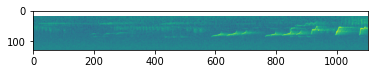

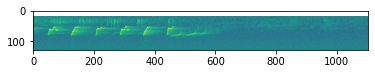

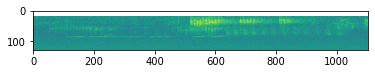

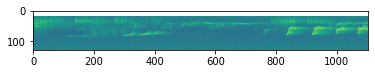

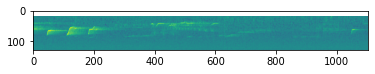

...

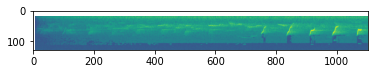

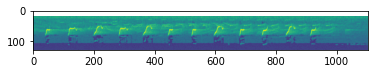

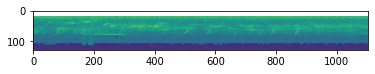

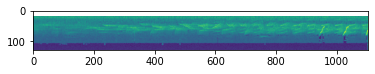

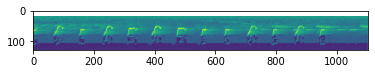

In [12]:
# print("Shape of waveform: {}".format(waveform.size()))
# print("Sample rate of waveform: {}".format(sample_rate))

# plt.figure()
# plt.plot(waveform.t().numpy())
import os

mels_path = "/content/gdrive/MyDrive/data/mels/"
spliced_path = "/content/gdrive/MyDrive/data/spliced_wav/"
# filename = "/content/gdrive/MyDrive/data/spliced_wav/0EmberizaCitrinella467354.wav"


audio_files = os.listdir(spliced_path)

for i in range(len(audio_files)):
  filename = audio_files[i]
  waveform, sample_rate = torchaudio.load(spliced_path + filename, normalization=True)
  # waveform, sample_rate = torchaudio.load(filename, normalization=True)
  specgram = torchaudio.transforms.MelSpectrogram(n_mels=128)(waveform)
  # print("Shape of spectrogram: {}".format(specgram.size()))
  plt.figure()
  plt.imshow(specgram.log2()[0,:,:].detach().numpy())
  plt.savefig(mels_path + filename[:-4])



In [31]:
# make csv file 
# first column = filename of spectogram (nothing needs to be done here)
# second column = extract the species name from filename (0FirstLast12345.png)
# 0 (train set - 80%), 1 (dev/test set - 20%)

import re
import csv
import random

string = "12FirstLast1234.png"
start = re.search(r"[a-zA-Z]", string).start()
str2 = string[start:]
end = re.search(r"\d", str2).start()
finalstr = str2[:end]


base_path = "/content/gdrive/MyDrive/data/"
# print(len(audio_files)) --> about 7000 files

with open(base_path + 'dataset1.csv', mode='w') as csv_file:
    fieldnames = ['filename', 'species_name', 'type']
    writer = csv.DictWriter(csv_file, fieldnames=fieldnames)
    
    writer.writeheader()

    mels_path = "/content/gdrive/MyDrive/data/mels/"
    mels = os.listdir(mels_path)

    for filename in mels:
      orig_name = filename
      start = re.search(r"[a-zA-Z]", filename).start()
      str2 = filename[start:]
      end = re.search(r"\d", str2).start()
      species_name = str2[:end]

      values = [0, 1]
      val = random.choices(values, weights=(80, 10))
      
      writer.writerow({'filename': orig_name, 'species_name': species_name, 'type': val})



In [ ]:
# !pip install scipy
# !pip install pandas